In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import chart_studio.plotly as py
import plotly.graph_objs as go
import plotly.express as px
plotly.offline.init_notebook_mode()
import cufflinks


from sklearn.linear_model import LinearRegression, Lasso,Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error,mean_absolute_error

plt.style.use('ggplot')
from pandas_profiling import ProfileReport

# Incidente viales

El Centro de Comando, Control, Cómputo, Comunicaciones y Contacto Ciudadano de la CDMX (C5), es la dependencia del Gobierno de la Ciudad de México encargada de captar información integral para la toma de decisiones en materia de seguridad pública, urgencias médicas, medio ambiente, protección civil, movilidad y servicios a la comunidad en la capital del país a través del video monitoreo, de la captación de llamadas telefónicas y de aplicaciones informáticas de inteligencia, enfocadas a mejorar la calidad de vida de las y los capitalinos. Cada incidente registrado genera un folio único identificador, excepto las llamadas no procedentes o “falsas” (bromas, niños jugando, etc.) que se reciben por distintos medios.  Mientras un folio está abierto; es decir, mientras el registro está siendo atendido, éste no se carga en la base de datos interna, una vez que el folio ha sido cerrado éste se refleja en el sistema y es posible visibilizarlo internamente con un día de vencimiento, pues se realiza una recarga diaria (por esta razón las fechas de inicio y cierre de folio no necesariamente coinciden).

## Cuantos accidentes por colonia o delegacion habra

In [2]:
df_all = pd.read_csv('../Data/incidentes-viales-c5.csv')
df_all['fecha_creacion'] = pd.to_datetime(df_all['fecha_creacion'])
df_all['fecha_cierre'] = pd.to_datetime(df_all['fecha_cierre'])

print(df_all.shape)
df_all.head()


(1397992, 18)


,folio,fecha_creacion,hora_creacion,dia_semana,codigo_cierre,fecha_cierre,año_cierre,mes_cierre,hora_cierre,delegacion_inicio,incidente_c4,latitud,longitud,clas_con_f_alarma,tipo_entrada,delegacion_cierre,geopoint,mes
0,GA/160123/05714,2016-01-23,22:35:04,Sábado,(A) La unidad de atención a emergencias fue de...,2016-01-24,2016,Enero,00:21:08,VENUSTIANO CARRANZA,accidente-choque sin lesionados,19.422113,-99.084643,EMERGENCIA,BOTÓN DE AUXILIO,VENUSTIANO CARRANZA,"19.422113,-99.084643",1
1,AO/160123/05826,2016-01-23,22:50:49,Sábado,(A) La unidad de atención a emergencias fue de...,2016-01-24,2016,Enero,04:40:37,CUAJIMALPA,accidente-choque con lesionados,19.358320,-99.297641,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,CUAJIMALPA,"19.35832,-99.297641",1
2,C4/160124/02187,2016-01-24,09:40:11,Domingo,(N) La unidad de atención a emergencias fue de...,2016-01-24,2016,Enero,11:13:03,TLALPAN,accidente-choque sin lesionados,19.217070,-99.219070,EMERGENCIA,LLAMADA DEL 066,TLALPAN,"19.21707,-99.21907008",1
3,C4/160124/05723,2016-01-24,22:40:57,Domingo,(N) La unidad de atención a emergencias fue de...,2016-01-24,2016,Enero,22:55:51,MAGDALENA CONTRERAS,accidente-choque sin lesionados,19.320580,-99.241010,EMERGENCIA,LLAMADA DEL 066,MAGDALENA CONTRERAS,"19.32057999,-99.24100992",1
4,C4/160124/01334,2016-01-24,04:25:15,Domingo,(A) La unidad de atención a emergencias fue de...,2016-01-24,2016,Enero,05:03:59,MIGUEL HIDALGO,accidente-choque sin lesionados,19.452900,-99.215870,EMERGENCIA,LLAMADA DEL 066,MIGUEL HIDALGO,"19.45289997,-99.21587004",1


In [3]:
df_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1397992 entries, 0 to 1397991
Data columns (total 18 columns):
 #   Column             Non-Null Count    Dtype         
---  ------             --------------    -----         
 0   folio              1397992 non-null  object        
 1   fecha_creacion     1397992 non-null  datetime64[ns]
 2   hora_creacion      1397992 non-null  object        
 3   dia_semana         1397992 non-null  object        
 4   codigo_cierre      1397992 non-null  object        
 5   fecha_cierre       1397992 non-null  datetime64[ns]
 6   año_cierre         1397992 non-null  int64         
 7   mes_cierre         1397992 non-null  object        
 8   hora_cierre        1397992 non-null  object        
 9   delegacion_inicio  1397834 non-null  object        
 10  incidente_c4       1397992 non-null  object        
 11  latitud            1397549 non-null  float64       
 12  longitud           1397557 non-null  float64       
 13  clas_con_f_alarma  1397992 

### AED con toda la data

In [4]:
#profile = ProfileReport(df_all, title="Reporte inicial con toda la data", explorative=True)
#profile.to_file("df_all_report_inicial.html")

Comencemos filtrando la data que no es necesaria como casos de llamadas duplicada.

In [5]:
df_all['codigo_de_cierre'] = df_all.codigo_cierre.str[:3].str[1]

<AxesSubplot:>

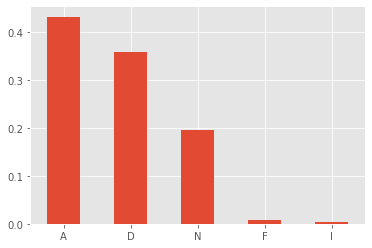

In [6]:
df_all.codigo_de_cierre.value_counts(normalize=True).plot.bar(rot=0)

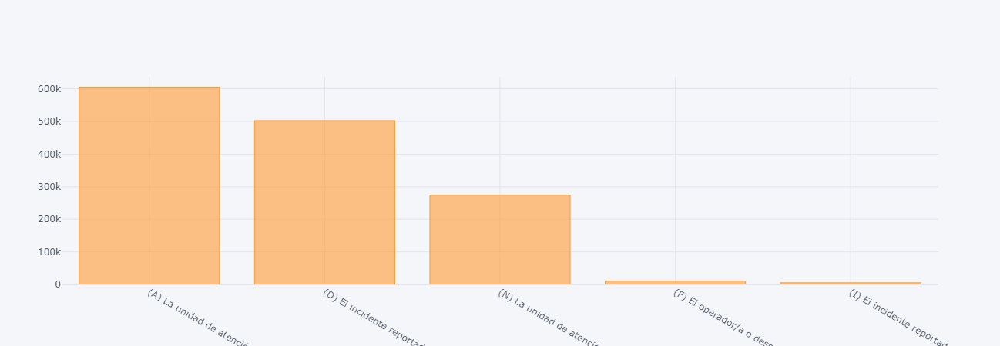

In [7]:
df_all.codigo_cierre.value_counts().iplot(kind='bar')

### Filtro de solo quedarnos con las llamadas Afirmativas (A, I)

In [8]:
df_A = df_all[df_all.codigo_de_cierre.isin(['A','I'])]
# df_all = df_all[df_all.codigo_de_cierre != 'D']

In [9]:
df_A.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 610203 entries, 0 to 1397988
Data columns (total 19 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   folio              610203 non-null  object        
 1   fecha_creacion     610203 non-null  datetime64[ns]
 2   hora_creacion      610203 non-null  object        
 3   dia_semana         610203 non-null  object        
 4   codigo_cierre      610203 non-null  object        
 5   fecha_cierre       610203 non-null  datetime64[ns]
 6   año_cierre         610203 non-null  int64         
 7   mes_cierre         610203 non-null  object        
 8   hora_cierre        610203 non-null  object        
 9   delegacion_inicio  610193 non-null  object        
 10  incidente_c4       610203 non-null  object        
 11  latitud            610072 non-null  float64       
 12  longitud           610074 non-null  float64       
 13  clas_con_f_alarma  610203 non-null  object 

In [10]:
print('Numero de llamadas recibidas: ',df_all.shape[0])
print('Numero de accidentes afirmados: ',df_A.shape[0])

Numero de llamadas recibidas:  1397992
Numero de accidentes afirmados:  610203


### Del Reporte de AED observamos que hay muy pocos nulos, los quitaremos

In [11]:
nulos = df_A.isnull().sum()/df_A.shape[0]
nulos[nulos!=0]

delegacion_inicio    0.000016
latitud              0.000215
longitud             0.000211
geopoint             0.000218
dtype: float64

In [12]:
df_A.dropna(inplace=True)

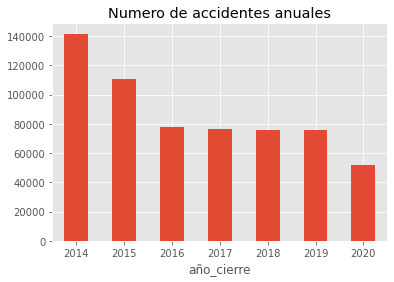

In [13]:
df_A.groupby('año_cierre').size().plot(title='Numero de accidentes anuales',kind='bar',rot=0);

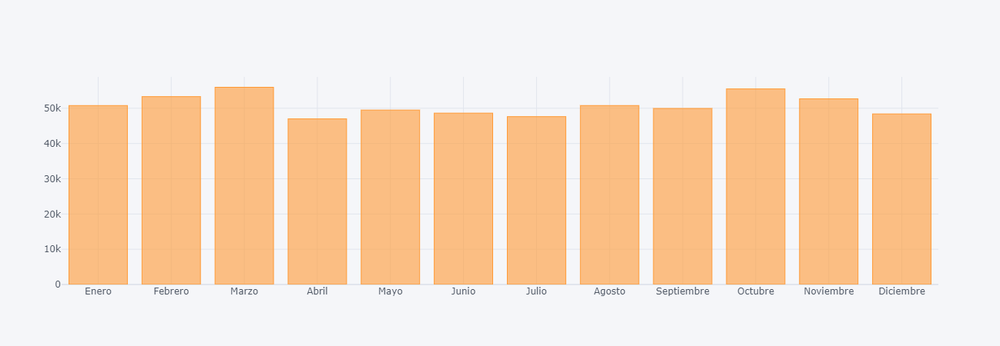

In [14]:
mes_dict = {1:'Enero',2:'Febrero',3:'Marzo',4:'Abril',5:'Mayo',6:'Junio',7:'Julio',8:'Agosto',9:'Septiembre',10:'Octubre',11:'Noviembre',12:'Diciembre'}
plot_temp = df_A.groupby('mes').size()
plot_temp.index = plot_temp.index.map(mes_dict)
plot_temp.iplot(kind='bar')

In [15]:
dia_dict_2 = {'Lunes':1,'Martes':2,'Miércoles':3,'Jueves':4,'Viernes':5,'Sábado':6,'Domingo':7}
dia_dict_1 = {1:'Lunes',2:'Martes',3:'Miércoles',4:'Jueves',5:'Viernes',6:'Sábado',7:'Domingo'}

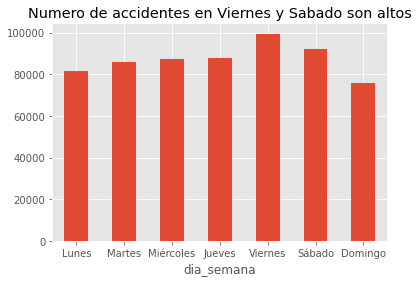

In [16]:

temp_plot = df_A.groupby('dia_semana').size()
temp_plot.index = temp_plot.index.map(dia_dict_2)
temp_plot = temp_plot.sort_index()
temp_plot.index = temp_plot.index.map(dia_dict_1)
temp_plot.plot(title='Numero de accidentes en Viernes y Sabado son altos', kind='bar', rot=0);

In [17]:
pd.Series(df_A.groupby('fecha_cierre').size().index).value_counts()

2020-06-05    1
2019-04-19    1
2019-02-23    1
2016-02-21    1
2018-05-30    1
             ..
2020-11-14    1
2018-05-18    1
2015-02-15    1
2016-07-10    1
2017-06-23    1
Name: fecha_cierre, Length: 2525, dtype: int64

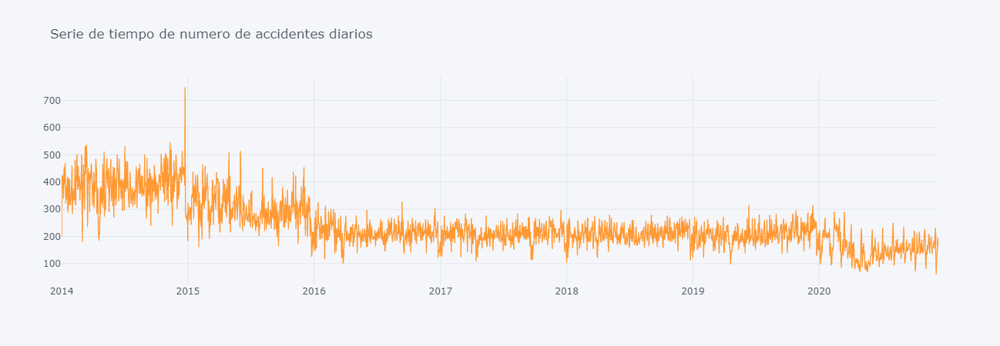

In [18]:
df_A.groupby('fecha_cierre').size().iplot(title='Serie de tiempo de numero de accidentes diarios')

In [19]:
df_A.groupby('fecha_cierre').size().describe()

count    2525.000000
mean      241.607921
std        85.793471
min        62.000000
25%       188.000000
50%       221.000000
75%       275.000000
max       748.000000
dtype: float64

<AxesSubplot:xlabel='año_cierre', ylabel='mes'>

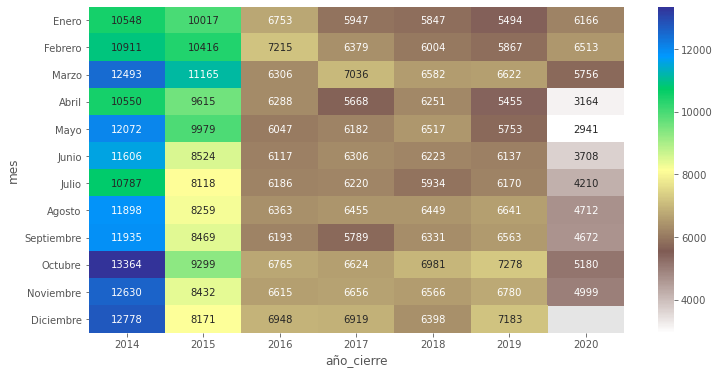

In [20]:
plot_temp = df_A.groupby(['mes','año_cierre']).size().unstack()
plot_temp.index = plot_temp.index.map(mes_dict)
plt.figure(figsize=(12,6))
sns.heatmap(plot_temp,cmap='terrain_r', annot=True, fmt='.0f')

<AxesSubplot:xlabel='año_cierre', ylabel='delegacion_cierre'>

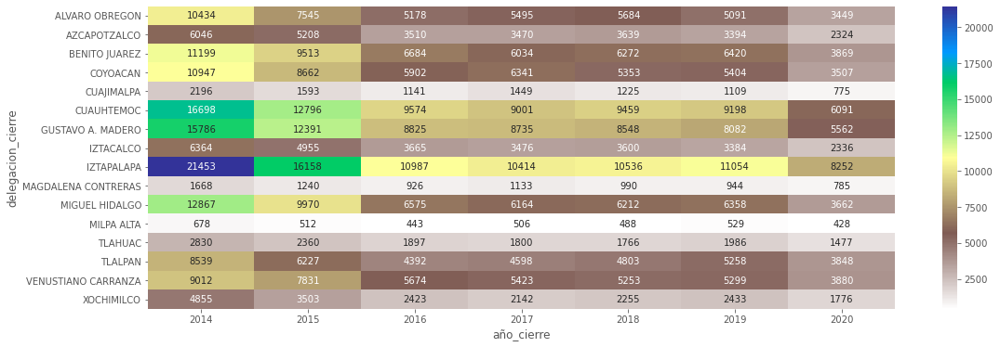

In [21]:
# stats de numero de accidentes por delegacion anio
plt.figure(figsize=(18,6))
sns.heatmap(df_A.groupby(['delegacion_cierre', 'año_cierre']).size().unstack(),cmap='terrain_r', annot=True, fmt='.0f')

In [22]:
df_A.columns

Index(['folio', 'fecha_creacion', 'hora_creacion', 'dia_semana',
       'codigo_cierre', 'fecha_cierre', 'año_cierre', 'mes_cierre',
       'hora_cierre', 'delegacion_inicio', 'incidente_c4', 'latitud',
       'longitud', 'clas_con_f_alarma', 'tipo_entrada', 'delegacion_cierre',
       'geopoint', 'mes', 'codigo_de_cierre'],
      dtype='object')

In [23]:
token = open('token_map.txt',mode='r')
token_map = token.read()
token.close()
px.set_mapbox_access_token(token_map)

### Un mapita porque fancy

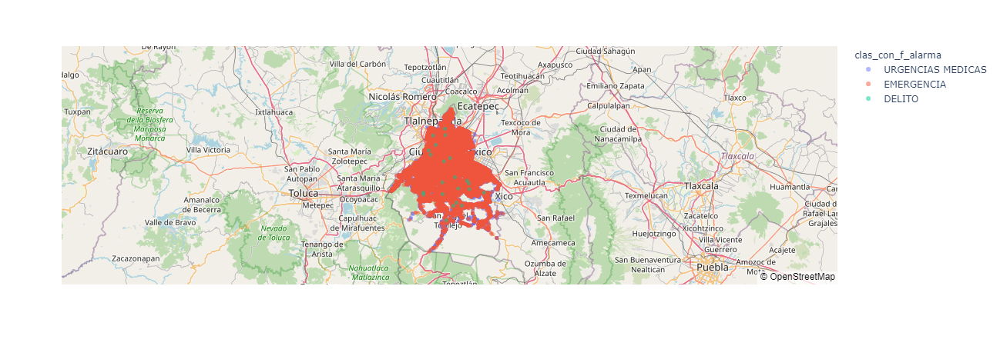

In [24]:
sample = df_A.sample(frac=0.1)
px.scatter_mapbox(sample, lat="latitud", lon="longitud",color='clas_con_f_alarma',opacity=0.5, 
                  hover_data=['delegacion_cierre','incidente_c4'],mapbox_style='open-street-map')

### Mapa de calor en mapa

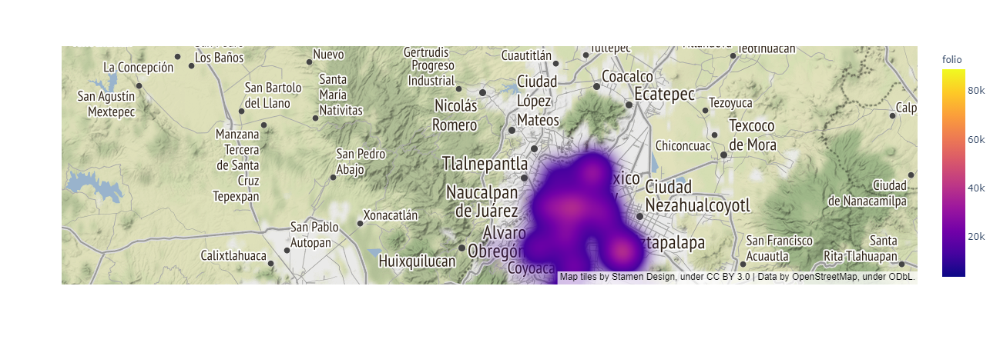

In [25]:
df_map = df_A.groupby('delegacion_cierre')[['latitud','longitud','folio']].agg({'latitud':'mean','longitud':'mean','folio':'count'}) 
fig = px.density_mapbox(df_map, lat='latitud', lon='longitud', z='folio', radius=50,
                        center=dict(lat=19.5, lon=-99.3), zoom=9,
                        mapbox_style="stamen-terrain")
fig.show()

## Trabajar en mallado del mapa

## Clustering para juntar modelos

In [26]:
df_temp = df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack(0).fillna(0)
df_temp

fecha_cierre,2014-01-01,2014-01-02,2014-01-03,2014-01-04,2014-01-05,2014-01-06,2014-01-07,2014-01-08,2014-01-09,2014-01-10,...,2020-12-02,2020-12-03,2020-12-04,2020-12-05,2020-12-06,2020-12-07,2020-12-08,2020-12-09,2020-12-10,2020-12-11
delegacion_cierre,,,,,,,,,,,,,,,,,,,,,
ALVARO OBREGON,12.0,25.0,29.0,33.0,27.0,30.0,38.0,34.0,17.0,20.0,...,19.0,9.0,9.0,6.0,8.0,10.0,9.0,14.0,10.0,14.0
AZCAPOTZALCO,8.0,16.0,12.0,22.0,7.0,11.0,10.0,21.0,18.0,20.0,...,4.0,12.0,4.0,5.0,9.0,3.0,6.0,10.0,1.0,11.0
BENITO JUAREZ,10.0,31.0,36.0,47.0,20.0,14.0,23.0,38.0,28.0,36.0,...,34.0,25.0,6.0,5.0,8.0,7.0,11.0,12.0,17.0,9.0
COYOACAN,7.0,43.0,31.0,42.0,22.0,36.0,26.0,22.0,29.0,30.0,...,25.0,15.0,4.0,1.0,6.0,7.0,8.0,17.0,12.0,11.0
CUAJIMALPA,0.0,7.0,5.0,4.0,4.0,3.0,13.0,6.0,11.0,4.0,...,0.0,1.0,3.0,0.0,3.0,0.0,1.0,5.0,4.0,1.0
CUAUHTEMOC,15.0,47.0,37.0,42.0,46.0,49.0,49.0,51.0,40.0,40.0,...,31.0,29.0,9.0,9.0,18.0,16.0,18.0,24.0,27.0,20.0
GUSTAVO A. MADERO,36.0,53.0,48.0,59.0,29.0,46.0,37.0,33.0,43.0,60.0,...,17.0,30.0,8.0,5.0,23.0,20.0,15.0,21.0,19.0,18.0
IZTACALCO,8.0,24.0,11.0,19.0,13.0,12.0,9.0,14.0,13.0,24.0,...,7.0,11.0,8.0,4.0,6.0,5.0,5.0,7.0,8.0,9.0
IZTAPALAPA,51.0,57.0,71.0,44.0,54.0,41.0,52.0,97.0,57.0,98.0,...,28.0,24.0,16.0,9.0,20.0,13.0,27.0,35.0,32.0,24.0


In [27]:
from sklearn.cluster import KMeans

### Metrica del codo

In [28]:
inertia = []
for i in range(1,16):
    kmeans_temp = KMeans(n_clusters = i)
    kmeans_temp.fit(df_temp)
    inertia.append(kmeans_temp.inertia_)
#     df_inertia = pd.concat([df_inertia,df_temp])

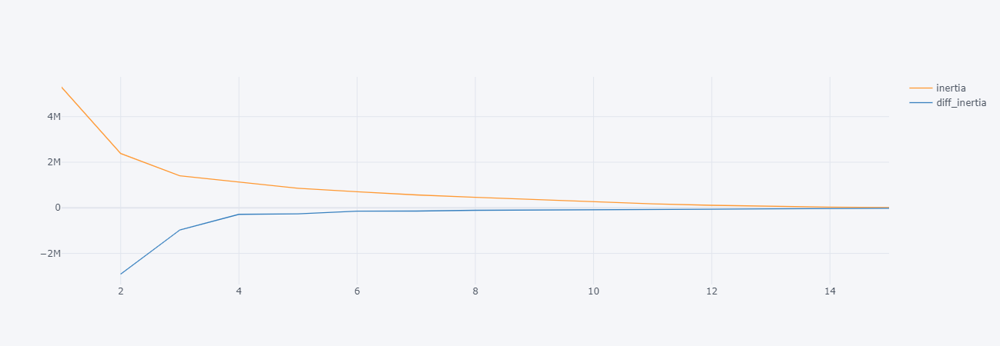

In [29]:
df_inertia = pd.DataFrame(inertia,index=range(1,16),columns=['inertia'])
df_inertia['diff_inertia'] = df_inertia.inertia.diff()
df_inertia.iplot()
# Creo en k_cluster = 4 converge...

In [30]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(df_temp)

df_temp['cluster'] = kmeans.predict(df_temp)

<AxesSubplot:>

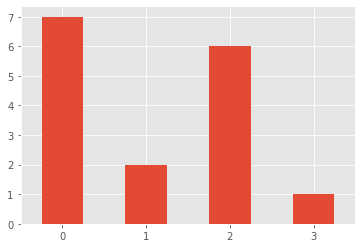

In [31]:
df_temp.cluster.value_counts(normalize=False).plot.bar(rot=0)

In [32]:
df_temp.groupby('cluster').mean().T.mean(0)

cluster
0     6.202659
1    27.870495
2    17.876436
3    35.189703
dtype: float64

In [33]:
# Accidentes promedio por cluster
df_temp.groupby('cluster').mean().T.describe()

cluster,0,1,2,3
count,2525.000000,2525.000000,2525.000000,2525.000000
mean,6.202659,27.870495,17.876436,35.189703
std,2.272642,10.791243,6.935467,14.905488
min,1.428571,5.500000,3.500000,8.000000
25%,4.714286,21.000000,13.333333,25.000000
50%,5.714286,26.000000,16.333333,32.000000
75%,7.285714,32.500000,20.666667,41.000000
max,18.571429,79.500000,62.500000,100.000000


Los cluster se diferencian por:
- 0 Promedio de 6 accidentes diarios, std baja. Delegaciones con pocos accidentes
- 1 Promedio de accidentes 17, std baja, Delegaciones con pocos accidentes
- 2 Promedio de accidentes 27, std alto, Delegaciones con accidentes
- 3 Promedio de accidentes 35, std alto, Delegaciones con muchos accidentes

## Analisis de correlacion por delegaciones

In [34]:
df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack(1).fillna(0)

delegacion_cierre,ALVARO OBREGON,AZCAPOTZALCO,BENITO JUAREZ,COYOACAN,CUAJIMALPA,CUAUHTEMOC,GUSTAVO A. MADERO,IZTACALCO,IZTAPALAPA,MAGDALENA CONTRERAS,MIGUEL HIDALGO,MILPA ALTA,TLAHUAC,TLALPAN,VENUSTIANO CARRANZA,XOCHIMILCO
fecha_cierre,,,,,,,,,,,,,,,,
2014-01-01,12.0,8.0,10.0,7.0,0.0,15.0,36.0,8.0,51.0,3.0,6.0,5.0,5.0,8.0,17.0,8.0
2014-01-02,25.0,16.0,31.0,43.0,7.0,47.0,53.0,24.0,57.0,8.0,16.0,7.0,17.0,36.0,26.0,12.0
2014-01-03,29.0,12.0,36.0,31.0,5.0,37.0,48.0,11.0,71.0,12.0,38.0,2.0,19.0,40.0,18.0,9.0
2014-01-04,33.0,22.0,47.0,42.0,4.0,42.0,59.0,19.0,44.0,6.0,44.0,3.0,5.0,26.0,22.0,5.0
2014-01-05,27.0,7.0,20.0,22.0,4.0,46.0,29.0,13.0,54.0,0.0,31.0,1.0,7.0,37.0,33.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-07,10.0,3.0,7.0,7.0,0.0,16.0,20.0,5.0,13.0,3.0,10.0,2.0,10.0,11.0,10.0,7.0
2020-12-08,9.0,6.0,11.0,8.0,1.0,18.0,15.0,5.0,27.0,2.0,5.0,3.0,1.0,9.0,15.0,5.0
2020-12-09,14.0,10.0,12.0,17.0,5.0,24.0,21.0,7.0,35.0,1.0,10.0,0.0,7.0,15.0,12.0,6.0


<AxesSubplot:xlabel='delegacion_cierre', ylabel='delegacion_cierre'>

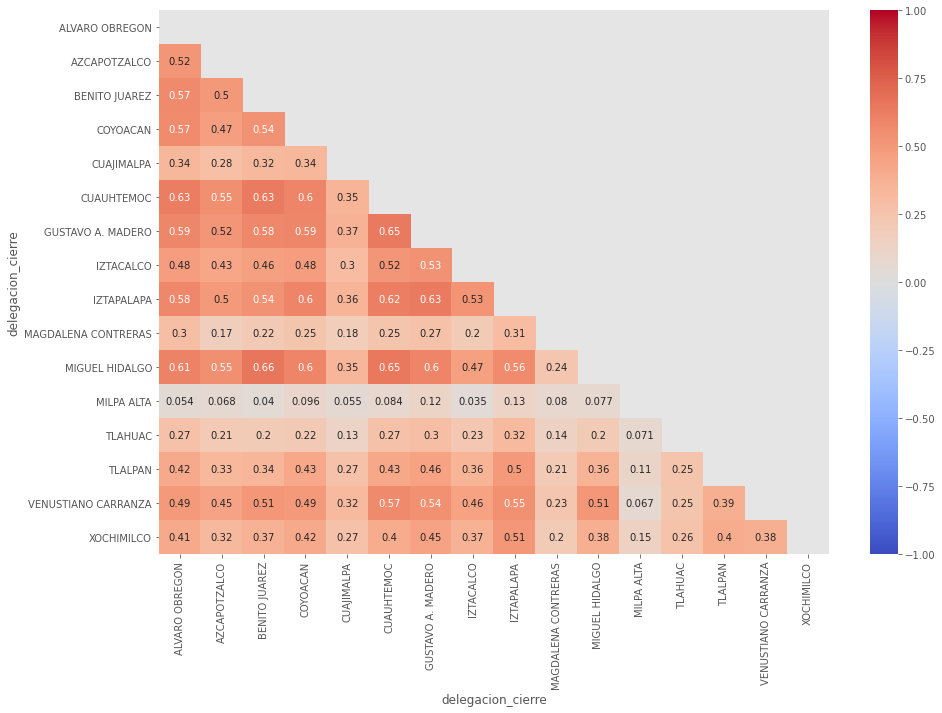

In [35]:
df_corr = df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack(1).fillna(0).corr()

mask = np.triu(np.ones_like(df_corr))

plt.figure(figsize=(15,10))
sns.heatmap(df_corr,vmin=-1,vmax=1,annot=True,cmap='coolwarm',mask=mask)

In [36]:
mask = np.triu(np.ones_like(df_corr)).astype(np.bool)
df_corr[mask] = np.nan
df_corr

delegacion_cierre,ALVARO OBREGON,AZCAPOTZALCO,BENITO JUAREZ,COYOACAN,CUAJIMALPA,CUAUHTEMOC,GUSTAVO A. MADERO,IZTACALCO,IZTAPALAPA,MAGDALENA CONTRERAS,MIGUEL HIDALGO,MILPA ALTA,TLAHUAC,TLALPAN,VENUSTIANO CARRANZA,XOCHIMILCO
delegacion_cierre,,,,,,,,,,,,,,,,
ALVARO OBREGON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AZCAPOTZALCO,0.515772,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BENITO JUAREZ,0.571819,0.501436,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
COYOACAN,0.565085,0.473577,0.536352,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CUAJIMALPA,0.341204,0.283600,0.324220,0.341871,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CUAUHTEMOC,0.625099,0.552052,0.634191,0.595837,0.353507,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GUSTAVO A. MADERO,0.590765,0.522668,0.584306,0.587680,0.373420,0.647540,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IZTACALCO,0.482134,0.432453,0.461051,0.479620,0.304761,0.515848,0.534501,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IZTAPALAPA,0.583688,0.496549,0.538810,0.597063,0.359222,0.618471,0.634508,0.528218,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [37]:
for i in df_corr.columns:
    for j in df_corr.columns:
        value = round(df_corr.loc[i,j],3)
        if value > 0.6:
            print(i,j,value)

CUAUHTEMOC ALVARO OBREGON 0.625
CUAUHTEMOC BENITO JUAREZ 0.634
GUSTAVO A. MADERO CUAUHTEMOC 0.648
IZTAPALAPA CUAUHTEMOC 0.618
IZTAPALAPA GUSTAVO A. MADERO 0.635
MIGUEL HIDALGO ALVARO OBREGON 0.605
MIGUEL HIDALGO BENITO JUAREZ 0.657
MIGUEL HIDALGO COYOACAN 0.601
MIGUEL HIDALGO CUAUHTEMOC 0.655


Delegaciones correlacionadas

Veamos si si....

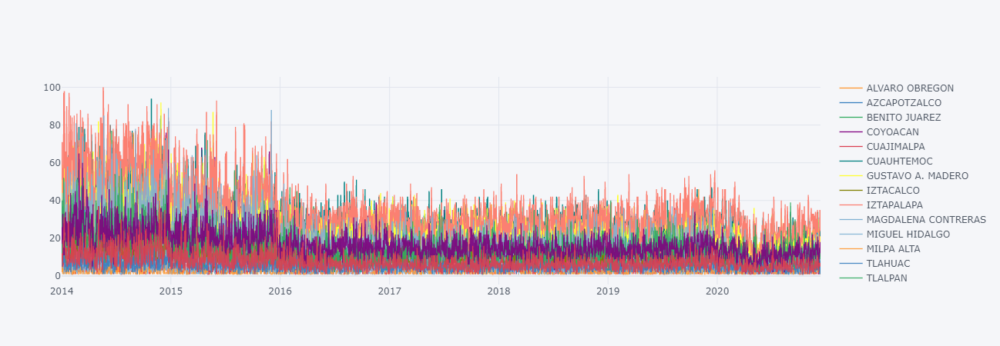

In [38]:
df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack().iplot()

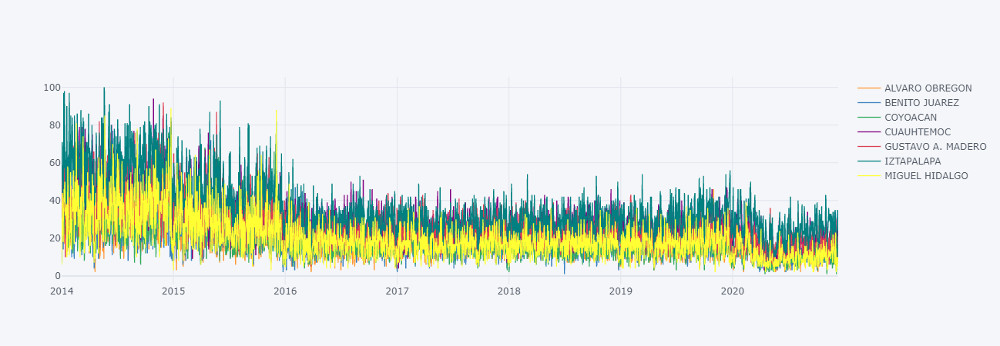

In [39]:
df_temp = df_A[df_A.delegacion_cierre.isin(
    ['CUAUHTEMOC', 'ALVARO OBREGON','BENITO JUAREZ','GUSTAVO A. MADERO',
     'IZTAPALAPA','MIGUEL HIDALGO','COYOACAN'])].groupby(
    ['fecha_cierre','delegacion_cierre']).size().unstack()
df_temp.iplot()

## Del analisis de correlacion obtener un clustering jerarquico

In [40]:
from scipy.cluster.hierarchy import dendrogram, linkage

In [41]:
df_corr = df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack(1).fillna(0).corr()
H = linkage(df_corr, 'single')

In [42]:
df_corr

delegacion_cierre,ALVARO OBREGON,AZCAPOTZALCO,BENITO JUAREZ,COYOACAN,CUAJIMALPA,CUAUHTEMOC,GUSTAVO A. MADERO,IZTACALCO,IZTAPALAPA,MAGDALENA CONTRERAS,MIGUEL HIDALGO,MILPA ALTA,TLAHUAC,TLALPAN,VENUSTIANO CARRANZA,XOCHIMILCO
delegacion_cierre,,,,,,,,,,,,,,,,
ALVARO OBREGON,1.000000,0.515772,0.571819,0.565085,0.341204,0.625099,0.590765,0.482134,0.583688,0.295151,0.605076,0.054499,0.271932,0.416515,0.493432,0.414728
AZCAPOTZALCO,0.515772,1.000000,0.501436,0.473577,0.283600,0.552052,0.522668,0.432453,0.496549,0.171099,0.548774,0.067906,0.209361,0.330272,0.451756,0.321229
BENITO JUAREZ,0.571819,0.501436,1.000000,0.536352,0.324220,0.634191,0.584306,0.461051,0.538810,0.217368,0.657280,0.040359,0.196755,0.344724,0.510798,0.371192
COYOACAN,0.565085,0.473577,0.536352,1.000000,0.341871,0.595837,0.587680,0.479620,0.597063,0.246507,0.600685,0.095784,0.218695,0.427537,0.494102,0.419398
CUAJIMALPA,0.341204,0.283600,0.324220,0.341871,1.000000,0.353507,0.373420,0.304761,0.359222,0.184837,0.349331,0.055383,0.131434,0.270505,0.319931,0.268817
CUAUHTEMOC,0.625099,0.552052,0.634191,0.595837,0.353507,1.000000,0.647540,0.515848,0.618471,0.251936,0.654925,0.084382,0.272058,0.425350,0.570392,0.403868
GUSTAVO A. MADERO,0.590765,0.522668,0.584306,0.587680,0.373420,0.647540,1.000000,0.534501,0.634508,0.266737,0.599806,0.119864,0.295038,0.455430,0.544817,0.451513
IZTACALCO,0.482134,0.432453,0.461051,0.479620,0.304761,0.515848,0.534501,1.000000,0.528218,0.199121,0.467618,0.034923,0.231702,0.356129,0.458516,0.368287
IZTAPALAPA,0.583688,0.496549,0.538810,0.597063,0.359222,0.618471,0.634508,0.528218,1.000000,0.306819,0.564681,0.132056,0.319967,0.498087,0.545482,0.510853


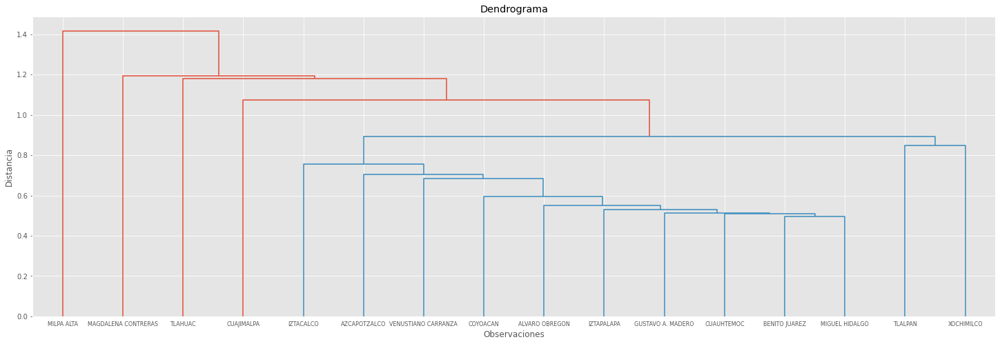

In [43]:
max_d = 7.08
fig, ax = plt.subplots(figsize=(25, 8))
plt.title('Dendrograma')
plt.xlabel('Observaciones')
plt.ylabel('Distancia')

dendrogram(
    H, truncate_mode='lastp',
    p=150, leaf_rotation=0.,
    leaf_font_size=8.,
)

plt.axhline(y=max_d, c='k')

name_alcaldias = dict(enumerate(df_corr.index.values))
pre_labels = [int(item.get_text()) for item in ax.get_xticklabels()]
labels = [name_alcaldias[x] for x in pre_labels]

ax.set_xticklabels(labels);


Dendograma de la correlacion por alcaldia.

# Primer modelo para una alcaldia con variables temporales

<AxesSubplot:xlabel='fecha_cierre'>

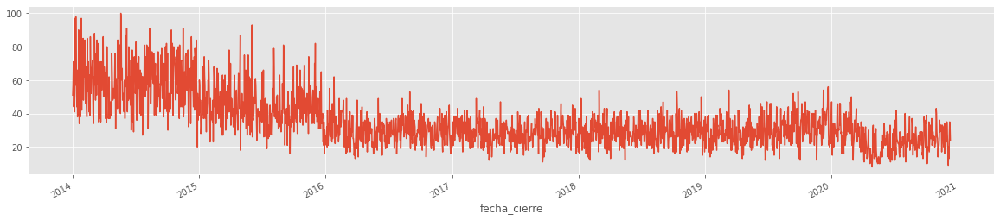

In [44]:
df_iztapalapa = df_A[df_A.delegacion_cierre == 'IZTAPALAPA'].groupby('fecha_cierre').size()
df_iztapalapa.plot(figsize=(20,4))

In [45]:
no_shift = pd.DataFrame(df_iztapalapa)
no_shift.columns = ['num_accidentes']
dict_temp = {}
for i in range(1,29):
    df_temp = pd.DataFrame(df_iztapalapa).shift(i).dropna()
    df_temp.columns = ['shift_'+str(i)]
    dict_temp['shift_'+str(i)] = df_temp

In [46]:
dfs = [x for x in dict_temp.values()]
dfs.append(no_shift)

In [47]:
from functools import reduce 
# Merge de DataFrames

df_merged = reduce(lambda  left, right: pd.merge(left,right,on='fecha_cierre',
                                            how='left'), dfs)

In [48]:
df_merged.head()

,shift_1,shift_2,shift_3,shift_4,shift_5,shift_6,shift_7,shift_8,shift_9,shift_10,...,shift_20,shift_21,shift_22,shift_23,shift_24,shift_25,shift_26,shift_27,shift_28,num_accidentes
fecha_cierre,,,,,,,,,,,,,,,,,,,,,
2014-01-02,51.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,57
2014-01-03,57.0,51.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71
2014-01-04,71.0,57.0,51.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44
2014-01-05,44.0,71.0,57.0,51.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54
2014-01-06,54.0,44.0,71.0,57.0,51.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41


In [49]:
# df_merged = df_merged.reset_index().set_index('fecha_cierre')

In [50]:
df_merged.dropna(inplace=True)

### Como utilizaremos variables de los shifts veamos la autocorrelacion

In [51]:
val_accidents = df_merged.num_accidentes.values
val_accidents = val_accidents.astype(float)

Text(0.5, 0, 'Shift o Lags')

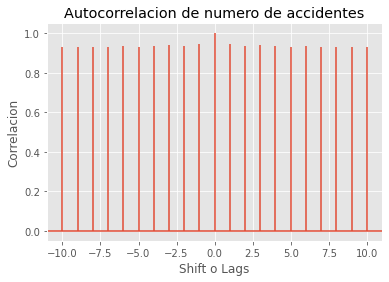

In [52]:
plt.acorr(val_accidents)
plt.title('Autocorrelacion de numero de accidentes')
plt.ylabel('Correlacion')
plt.xlabel('Shift o Lags')

### Hora de entrenar el modelo

In [53]:
df_merged.shape

(2497, 29)

In [54]:
print('Partición de datos, 80% train, 20% test')
train = df_merged[:2000]
test = df_merged[2000:]
y_train, y_test = train['num_accidentes'], test['num_accidentes']

print('entrenamiento modelo')
x_cols = [col for col in df_merged.columns if 'num_accidentes' != col]


lr = LinearRegression()
lr.fit(train[x_cols], y_train)

lasso = Lasso()
lasso.fit(train[x_cols], y_train)

ridge = Ridge()
ridge.fit(train[x_cols], y_train)

knn = KNeighborsRegressor(n_neighbors=10)
knn.fit(train[x_cols], y_train)

Partición de datos, 80% train, 20% test
entrenamiento modelo


KNeighborsRegressor(n_neighbors=10)

In [55]:
print('Evaluación del modelo')
models = [('lr',lr), ('lasso',lasso),('ridge',ridge),('Knn',knn)]


def evaluate_model(name):
    print('//'*20)
    print('modelo: ',name)
    print('//'*20)
    
    r2 = r2_score(test['num_accidentes'], test['y_pred_'+name])
    rmse = mean_squared_error(test['num_accidentes'], test['y_pred_'+name], squared=False)
    mae = mean_absolute_error(test['num_accidentes'], test['y_pred_'+name])
    mape = (np.mean(np.abs(test['num_accidentes'] - test['y_pred_'+name])/np.abs(test['num_accidentes']))*100)
    
    print('R^2 = % 1.3f' %r2)
    print('Error cuadrático medio (RMSE) = % 1.3f' %rmse)
    print('Error absoluto medio (MAE) = % 1.3f' %mae)
    print('MAPE: ',mape)
    return r2,rmse,mae,mape
    
    
for name,model in models:
    test['y_pred_'+name] = model.predict(test[x_cols])
    evaluate_model(name)

Evaluación del modelo
////////////////////////////////////////
modelo:  lr
////////////////////////////////////////
R^2 =  0.260
Error cuadrático medio (RMSE) =  7.682
Error absoluto medio (MAE) =  6.186
MAPE:  26.857752707853333
////////////////////////////////////////
modelo:  lasso
////////////////////////////////////////
R^2 =  0.265
Error cuadrático medio (RMSE) =  7.655
Error absoluto medio (MAE) =  6.166
MAPE:  26.861927387050887
////////////////////////////////////////
modelo:  ridge
////////////////////////////////////////
R^2 =  0.260
Error cuadrático medio (RMSE) =  7.682
Error absoluto medio (MAE) =  6.186
MAPE:  26.857754148384206
////////////////////////////////////////
modelo:  Knn
////////////////////////////////////////
R^2 = -0.066
Error cuadrático medio (RMSE) =  9.220
Error absoluto medio (MAE) =  7.503
MAPE:  35.690987997338716


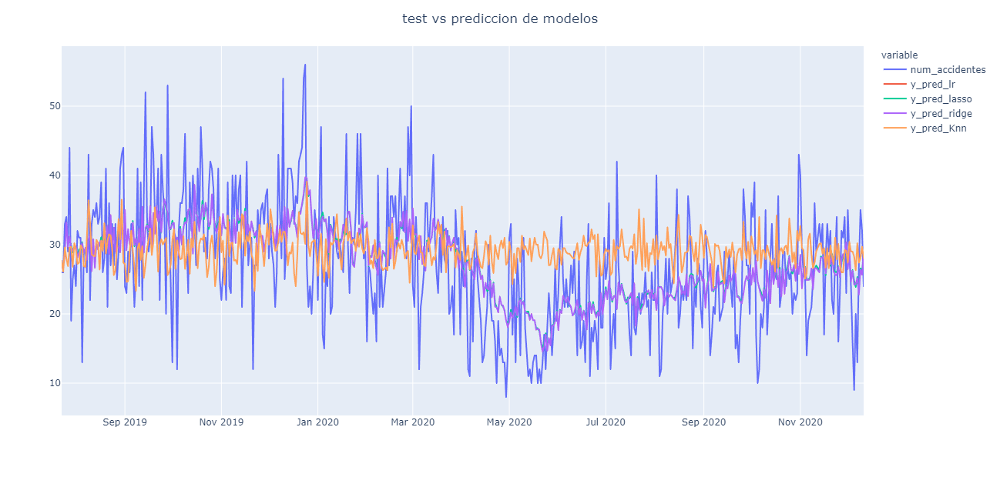

In [56]:
data_fig = test[x_cols]
fig_eval = px.line(test[['num_accidentes','y_pred_lr', 'y_pred_lasso', 'y_pred_ridge', 'y_pred_Knn']], x= test.index,
                   y=['num_accidentes','y_pred_lr', 'y_pred_lasso', 'y_pred_ridge', 'y_pred_Knn'])

fig_eval.update_layout(title='test vs prediccion de modelos', title_x=0.5, xaxis_title='',
                   yaxis_title='', width=1200, height=620)
fig_eval.show()

## Prueba de modelo con mas variables

In [57]:
df_merged

,shift_1,shift_2,shift_3,shift_4,shift_5,shift_6,shift_7,shift_8,shift_9,shift_10,...,shift_20,shift_21,shift_22,shift_23,shift_24,shift_25,shift_26,shift_27,shift_28,num_accidentes
fecha_cierre,,,,,,,,,,,,,,,,,,,,,
2014-01-29,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,34.0,57.0,...,57.0,97.0,52.0,41.0,54.0,44.0,71.0,57.0,51.0,49
2014-01-30,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,34.0,...,98.0,57.0,97.0,52.0,41.0,54.0,44.0,71.0,57.0,58
2014-01-31,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,...,73.0,98.0,57.0,97.0,52.0,41.0,54.0,44.0,71.0,85
2014-02-01,85.0,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,...,58.0,73.0,98.0,57.0,97.0,52.0,41.0,54.0,44.0,48
2014-02-02,48.0,85.0,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,...,44.0,58.0,73.0,98.0,57.0,97.0,52.0,41.0,54.0,66
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-07,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,31.0,32.0,...,28.0,17.0,33.0,30.0,33.0,29.0,36.0,25.0,21.0,13
2020-12-08,13.0,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,31.0,...,33.0,28.0,17.0,33.0,30.0,33.0,29.0,36.0,25.0,27
2020-12-09,27.0,13.0,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,...,29.0,33.0,28.0,17.0,33.0,30.0,33.0,29.0,36.0,35


In [58]:
df_max = pd.DataFrame()
df_min = pd.DataFrame()
df_mean = pd.DataFrame()
df_median = pd.DataFrame()
df_std = pd.DataFrame()
df_cociente = pd.DataFrame()

cols_temp = [col for col in df_merged.columns if 'shift' in col] # obtencion de columnas de lags sin diff y de la moneda que queremos
print(cols_temp)
for i in range(2, 29):
    lista_lags = list(range(1, i+1))
    cols_temp_2 =cols_temp[:i]

    df_max_temp = df_merged[cols_temp_2].max(1)
    df_max_temp.columns = ['shift_max_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_max = pd.concat([df_max, df_max_temp], 1)
    df_max.rename(columns={0:'shift_max_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

    df_min_temp = df_merged[cols_temp_2].min(1)
    df_min_temp.columns = ['shift_min_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_min = pd.concat([df_min, df_min_temp], 1)
    df_min.rename(columns={0:'shift_min_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

    df_mean_temp = df_merged[cols_temp_2].mean(1)
    df_mean_temp.columns = ['shift_mean_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_mean = pd.concat([df_mean, df_mean_temp], 1)
    df_mean.rename(columns={0:'shift_mean_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

    df_median_temp = df_merged[cols_temp_2].median(1)
    df_median_temp.columns = ['shift_median_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_median = pd.concat([df_median, df_median_temp], 1)
    df_median.rename(columns={0:'shift_median_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

    df_std_temp = df_merged[cols_temp_2].std(1)
    df_std_temp.columns = ['shift_std_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_std = pd.concat([df_std, df_std_temp], 1)
    df_std.rename(columns={0:'shift_std_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

    df_cociente_temp = df_merged[cols_temp_2[0]] / df_merged[cols_temp_2[-1]]
    df_cociente_temp.columns = ['shift_cociente_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])]
    df_cociente = pd.concat([df_cociente, df_cociente_temp], 1)
    df_cociente.rename(columns={0:'shift_cociente_t'+str(lista_lags[0])+'_t'+str(lista_lags[-1])}, inplace=True)

['shift_1', 'shift_2', 'shift_3', 'shift_4', 'shift_5', 'shift_6', 'shift_7', 'shift_8', 'shift_9', 'shift_10', 'shift_11', 'shift_12', 'shift_13', 'shift_14', 'shift_15', 'shift_16', 'shift_17', 'shift_18', 'shift_19', 'shift_20', 'shift_21', 'shift_22', 'shift_23', 'shift_24', 'shift_25', 'shift_26', 'shift_27', 'shift_28']


In [59]:
for df in [df_merged,df_max,df_min,df_mean,df_median,df_std,df_cociente]:
    df.index.names = ['date']
    df.index = pd.to_datetime(df.index)

In [60]:
data_frames = [df_merged,df_max,df_min,df_mean,df_median,df_std,df_cociente]

df_merged_2 = reduce(lambda  left, right: pd.merge(left,right,on=['date'],how='left'), data_frames)

In [61]:
df_merged_2

,shift_1,shift_2,shift_3,shift_4,shift_5,shift_6,shift_7,shift_8,shift_9,shift_10,...,shift_cociente_t1_t19,shift_cociente_t1_t20,shift_cociente_t1_t21,shift_cociente_t1_t22,shift_cociente_t1_t23,shift_cociente_t1_t24,shift_cociente_t1_t25,shift_cociente_t1_t26,shift_cociente_t1_t27,shift_cociente_t1_t28
date,,,,,,,,,,,,,,,,,,,,,
2014-01-29,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,34.0,57.0,...,0.724490,1.245614,0.731959,1.365385,1.731707,1.314815,1.613636,1.000000,1.245614,1.392157
2014-01-30,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,34.0,...,0.671233,0.500000,0.859649,0.505155,0.942308,1.195122,0.907407,1.113636,0.690141,0.859649
2014-01-31,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,56.0,...,1.000000,0.794521,0.591837,1.017544,0.597938,1.115385,1.414634,1.074074,1.318182,0.816901
2014-02-01,85.0,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,63.0,...,1.931818,1.465517,1.164384,0.867347,1.491228,0.876289,1.634615,2.073171,1.574074,1.931818
2014-02-02,48.0,85.0,58.0,49.0,71.0,42.0,97.0,55.0,70.0,38.0,...,0.727273,1.090909,0.827586,0.657534,0.489796,0.842105,0.494845,0.923077,1.170732,0.888889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-07,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,31.0,32.0,...,0.606061,0.714286,1.176471,0.606061,0.666667,0.606061,0.689655,0.555556,0.800000,0.952381
2020-12-08,13.0,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,31.0,...,0.448276,0.393939,0.464286,0.764706,0.393939,0.433333,0.393939,0.448276,0.361111,0.520000
2020-12-09,27.0,13.0,20.0,9.0,16.0,24.0,28.0,35.0,23.0,34.0,...,0.843750,0.931034,0.818182,0.964286,1.588235,0.818182,0.900000,0.818182,0.931034,0.750000


## Prueba de modelo

In [62]:
print('Partición de datos, 80% train, 20% test')
train = df_merged_2[:2000]
test = df_merged_2[2000:]
y_train, y_test = train['num_accidentes'], test['num_accidentes']

print('entrenamiento modelo')
x_cols = [col for col in df_merged_2.columns if 'num_accidentes' != col]


lr_2 = LinearRegression()
lr_2.fit(train[x_cols], y_train)

lasso_2 = Lasso()
lasso_2.fit(train[x_cols], y_train)

ridge_2 = Ridge()
ridge_2.fit(train[x_cols], y_train)

knn_2 = KNeighborsRegressor(n_neighbors=10)
knn_2.fit(train[x_cols], y_train)

Partición de datos, 80% train, 20% test
entrenamiento modelo


KNeighborsRegressor(n_neighbors=10)

In [63]:
models = [('lr',lr_2), ('lasso',lasso_2),('ridge',ridge_2),('Knn',knn_2)]

In [64]:
for name,model in models:
    print(name)
    test['y_pred_'+name] = model.predict(test[x_cols])
    evaluate_model(name)

lr
////////////////////////////////////////
modelo:  lr
////////////////////////////////////////
R^2 =  0.220
Error cuadrático medio (RMSE) =  7.887
Error absoluto medio (MAE) =  6.356
MAPE:  27.139323904673002
lasso
////////////////////////////////////////
modelo:  lasso
////////////////////////////////////////
R^2 =  0.263
Error cuadrático medio (RMSE) =  7.666
Error absoluto medio (MAE) =  6.176
MAPE:  26.80175548749694
ridge
////////////////////////////////////////
modelo:  ridge
////////////////////////////////////////
R^2 =  0.222
Error cuadrático medio (RMSE) =  7.878
Error absoluto medio (MAE) =  6.349
MAPE:  27.123387224650465
Knn
////////////////////////////////////////
modelo:  Knn
////////////////////////////////////////
R^2 =  0.013
Error cuadrático medio (RMSE) =  8.868
Error absoluto medio (MAE) =  7.168
MAPE:  33.759180390282836


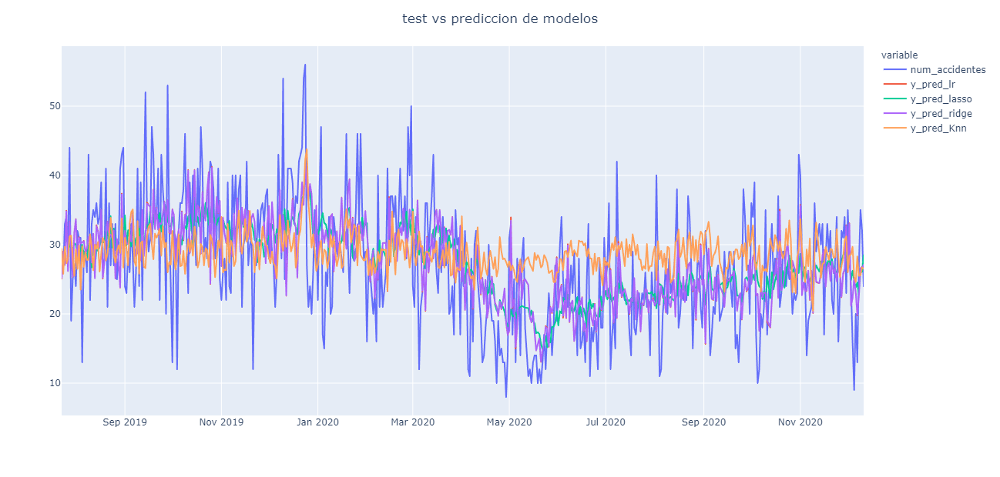

In [65]:
data_fig = test[x_cols]
fig_eval = px.line(test[['num_accidentes','y_pred_lr', 'y_pred_lasso', 'y_pred_ridge', 'y_pred_Knn']], x= test.index,
                   y=['num_accidentes','y_pred_lr', 'y_pred_lasso', 'y_pred_ridge', 'y_pred_Knn'])

fig_eval.update_layout(title='test vs prediccion de modelos', title_x=0.5, xaxis_title='',
                   yaxis_title='', width=1200, height=620)
fig_eval.show()

# Modelo con todas las variables

### Nivel Diario numero de accidentes

In [66]:
df_A.columns

Index(['folio', 'fecha_creacion', 'hora_creacion', 'dia_semana',
       'codigo_cierre', 'fecha_cierre', 'año_cierre', 'mes_cierre',
       'hora_cierre', 'delegacion_inicio', 'incidente_c4', 'latitud',
       'longitud', 'clas_con_f_alarma', 'tipo_entrada', 'delegacion_cierre',
       'geopoint', 'mes', 'codigo_de_cierre'],
      dtype='object')

In [67]:
# 2525 REGISTROS A NIVEL DIARIO
df_A.groupby('fecha_cierre').size()

fecha_cierre
2014-01-01    199
2014-01-02    425
2014-01-03    418
2014-01-04    423
2014-01-05    342
             ... 
2020-12-07    134
2020-12-08    140
2020-12-09    196
2020-12-10    183
2020-12-11    165
Length: 2525, dtype: int64

In [68]:
# 39302 A NIVEL DIARIO POR DELEGACION
df_alc_accidentes = df_A.groupby(['fecha_cierre','delegacion_cierre']).size()
df_alc_accidentes

fecha_cierre  delegacion_cierre  
2014-01-01    ALVARO OBREGON         12
              AZCAPOTZALCO            8
              BENITO JUAREZ          10
              COYOACAN                7
              CUAUHTEMOC             15
                                     ..
2020-12-11    MILPA ALTA              1
              TLAHUAC                 8
              TLALPAN                 9
              VENUSTIANO CARRANZA    17
              XOCHIMILCO              5
Length: 39302, dtype: int64

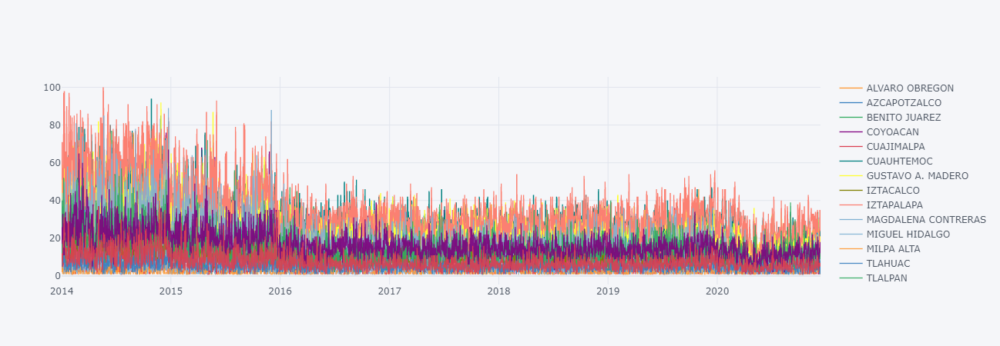

In [69]:
df_A.groupby(['fecha_cierre','delegacion_cierre']).size().unstack().iplot()